size(data.positions) = (100001,)


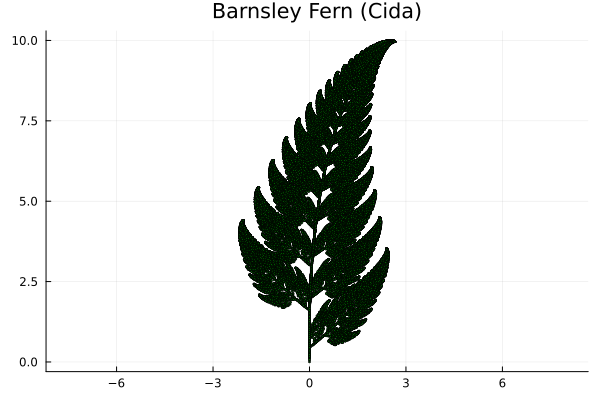

In [12]:
using StaticArrays, LinearAlgebra, Plots
abstract type AbstractIFS end

f1(v::SVector{2,Float64}) = SVector(0, 0.16 * v[2])
f2(v::SVector{2,Float64}) = SVector(0.2 * v[1] - 0.26 * v[2], 0.23 * v[1] + 0.22 * v[2] + 1.6)
f3(v::SVector{2,Float64}) = SVector(-0.15 * v[1] + 0.28 * v[2], 0.26 * v[1] + 0.24 * v[2] + 0.44)
f4(v::SVector{2,Float64}) = SVector(0.85 * v[1] + 0.04 * v[2], -0.04 * v[1] + 0.85 * v[2] + 1.6)
@kwdef struct Cida <: AbstractIFS
    maps::Vector{Function} = [f1, f2, f3, f4]
    weights::Vector{Float64} = [0.01, 0.07, 0.07, 0.85]
    positions::Vector{SVector{2,Float64}} = [SVector(0.0, 0.0)]
    level::Int = 0
end

function iterate(ifs::Cida, n::Int)
    new_positions = ifs.positions
    for _ in 1:n
        r = rand()
        cumulative_weight = 0.0
        for (i, w) in enumerate(ifs.weights)
            cumulative_weight += w
            if r <= cumulative_weight
                f = ifs.maps[i]
                p = ifs.positions[end]
                push!(new_positions, f(p))
                break
            end
        end
    end
    return Cida(maps=ifs.maps, weights=ifs.weights, positions=new_positions, level=ifs.level + 1)
end

data = iterate(Cida(), 100000)
@show size(data.positions)
mat = reduce(hcat, data.positions)
scatter(
    mat[1, :],
    mat[2, :],
    aspect_ratio=:equal,
    color=:green,
    markersize=1,
    legend=false,
    title="Barnsley Fern (Cida)"
)


size(data.positions) = (100001,)


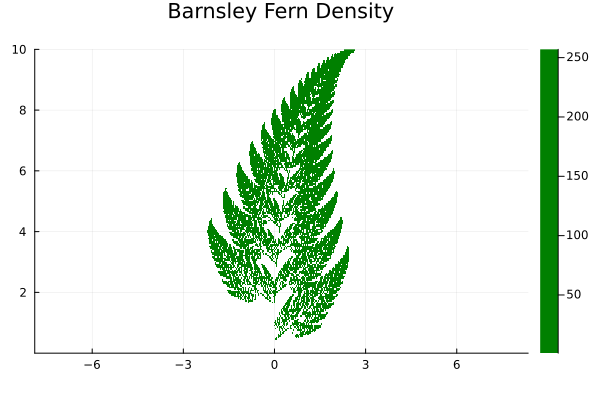

In [16]:
using StaticArrays, LinearAlgebra, Plots
abstract type AbstractIFS end

f1(v::SVector{2,Float64}) = SVector(0, 0.16 * v[2])
f2(v::SVector{2,Float64}) = SVector(0.2 * v[1] - 0.26 * v[2], 0.23 * v[1] + 0.22 * v[2] + 1.6)
f3(v::SVector{2,Float64}) = SVector(-0.15 * v[1] + 0.28 * v[2], 0.26 * v[1] + 0.24 * v[2] + 0.44)
f4(v::SVector{2,Float64}) = SVector(0.85 * v[1] + 0.04 * v[2], -0.04 * v[1] + 0.85 * v[2] + 1.6)
@kwdef struct Cida <: AbstractIFS
    maps::Vector{Function} = [f1, f2, f3, f4]
    weights::Vector{Float64} = [0.01, 0.07, 0.07, 0.85]
    positions::Vector{SVector{2,Float64}} = [SVector(0.0, 0.0)]
    level::Int = 0
end

function iterate(ifs::Cida, n::Int)
    new_positions = ifs.positions
    for _ in 1:n
        r = rand()
        cumulative_weight = 0.0
        for (i, w) in enumerate(ifs.weights)
            cumulative_weight += w
            if r <= cumulative_weight
                f = ifs.maps[i]
                p = ifs.positions[end]
                push!(new_positions, f(p))
                break
            end
        end
    end
    return Cida(maps=ifs.maps, weights=ifs.weights, positions=new_positions, level=ifs.level + 1)
end

data = iterate(Cida(), 100000)
@show size(data.positions)
mat = reduce(hcat, data.positions)
histogram2d(
    mat[1, :], mat[2, :],
    nbins=400, # 解像度
    color=:green,
    aspect_ratio=:equal,
    title="Barnsley Fern Density"
)


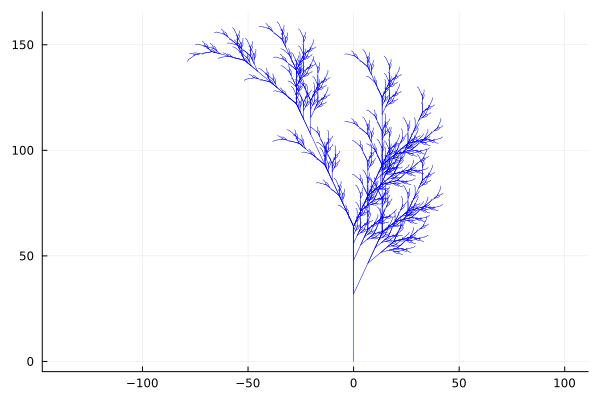

In [30]:
using StaticArrays, LinearAlgebra, Plots

abstract type AbstractTiles{N,T} end
function grow_tile(tile::AbstractTiles)
    new_str = sprint() do io
        for c in tile.str
            print(io, get(tile.rules, c, string(c)))
        end
    end
    new_level = tile.level + 1
    return (typeof(tile))(new_level, new_str, tile.positions, tile.angle, tile.rules)
end
function string2positions(tile::AbstractTiles{2,T}) where T
    pos = tile.positions[1]
    direction = SVector(0.0, 1.0)

    stack = Tuple{SVector{2,T},SVector{2,T}}[]
    positions = SVector{2,T}[]
    push!(positions, pos)
    for cmd in collect(tile.str)
        if cmd == 'F'
            pos += direction
            push!(positions, pos)
        elseif cmd == '+'
            θ = tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        elseif cmd == '-'
            θ = -tile.angle
            rot = @SMatrix [cos(θ) -sin(θ); sin(θ) cos(θ)]
            direction = rot * direction
        elseif cmd == '['
            push!(stack, (pos, direction))
        elseif cmd == ']'
            if !isempty(stack)
                pos, direction = pop!(stack)
                push!(positions, SVector{2,T}(NaN, NaN))
                push!(positions, pos)
            end
        end
    end
    return (typeof(tile))(tile.level, tile.str, positions, tile.angle, tile.rules)
end
@kwdef struct Cida{N,T} <: AbstractTiles{N,T}
    level::Int = 0
    str::String = "X"
    positions::Vector{SVector{N,T}} = [SVector{N,T}(zeros(T, N)...)]
    angle::Union{T,Nothing} = deg2rad(25.0)
    rules::Dict{Char,String} = Dict(
        'X' => "F-[[X]+X]+F[+FX]-X",
        'F' => "FF"
    )
end

tile = Cida{2,Float64}()

for g in 1:6
    tile = grow_tile(tile)
end
tile = string2positions(tile)

mat = reduce(hcat, tile.positions)
p = plot(aspect_ratio=1, legend=false)
plot!(p, mat[1, :], mat[2, :], lw=0.5, color=:blue)
